# Project Title
   Cinema Audience Segmentation: Exploring Patterns in Ticket Sales

# Project Objectives
1. Segmentation of Cinema Audience using Unsupervised Machine Learning Clustering Algorithms
- Utilize unsupervised machine learning clustering algorithms to segment the cinema audience based on their ticket purchasing behavior
- Problem Statement: Develop a method to segment the cinema audience into distinct groups using clustering techniques, such as     K-means and DBSCAN, to uncover hidden patterns and preferences.
   
2. Determination of Optimal Number of Audience Segments or Clusters

- Determine the optimal number of segments or clusters that best represent the diversity within the cinema audience.
- Identify the appropriate number of audience segments or clusters through techniques like silhouette analysis, elbow method, or silhouette scores to ensure meaningful and interpretable results.

3. Characterization of Audience Segments or Clusters

- Characterize each audience segment or cluster by analyzing their unique characteristics and preferences.
- Analyze the characteristics and preferences of each identified audience segment or cluster, such as movie genre preferences, frequency of ticket purchases, preferred show timings, etc., to gain insights into their behavior and tailor marketing strategies accordingly.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

from sklearn.cluster import DBSCAN, KMeans
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.model_selection import train_test_split
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [26]:
# Project Report
'''Project Title: Cinema Audience Segmentation: Exploring Patterns in Ticket Sales
1.	Project Objectives:
	Segmentation of Cinema Audience using Unsupervised Machine Learning Clustering Algorithms: Utilize unsupervised machine learning clustering algorithms to segment the cinema audience based on their ticket purchasing behavior. 
	Develop a method to segment the cinema audience into distinct groups using clustering techniques, such as K-means and DBSCAN, to uncover hidden patterns and preferences.
	Determination of Optimal Number of Audience Segments or Clusters: Determine the optimal number of segments or clusters that best represent the diversity within the cinema audience.
	Identify the appropriate number of audience segments or clusters through techniques like silhouette analysis, elbow method, or silhouette scores to ensure meaningful and interpretable results.
	Characterization of Audience Segments or Clusters: Characterize each audience segment or cluster by analyzing their unique characteristics and preferences.
	Analyze the characteristics and preferences of each identified audience segment or cluster, such as movie genre preferences, frequency of ticket purchases, preferred show timings, etc., to gain insights into their behavior and tailor marketing strategies accordingly.

2. Description of Data
	Data Source, Size, Shape
	Data Source (Website Link): Cinema Ticket Dataset on Kaggle
	Data Size: 15,588.69 KB
	Data Shape | Dimension: 14 variables | 142,524 records

	Description of Variables
	Index Variable(s): [None]
	Variables or Features having Categories | Categorical Variables or Features (CV):  'date'
	Variables or Features having Nominal Categories | Categorical Variables or Features- Nominal Type: 'date'
	Variables or Features having Ordinal Categories | Categorical Variables or Features- Ordinal Type: [None]
	Non-Categorical Variables or Features:
'film_code', 'cinema_code', 'total_sales', 'tickets_sold', 'tickets_out', 'show_time', 'occu_perc', 'ticket_price', 'ticket_use', 'capacity', 'month', 'quarter', 'day'.
	Descriptive Statistics:
	Descriptive Statistics for Categorical Variables or Features (Count | Frequency):
Date:
2018-05-15: 790
2018-05-08: 784
2018-05-11: 778
2018-05-10: 774
2018-05-09: 766
...
2018-06-05: 4
2018-10-30: 2
2018-02-23: 1
2018-02-21: 1
2018-09-21: 1
	Proportion (Relative Frequency) Statistics:
Date:
2018-05-15: 0.005543
2018-05-08: 0.005501
2018-05-11: 0.005459
2018-05-10: 0.005431
2018-05-09: 0.005375
...
2018-06-05: 0.000028
2018-10-30: 0.000014
2018-02-23: 0.000007
2018-02-21: 0.000007
2018-09-21: 0.000007
	Descriptive Statistics for Non-Categorical Variables or Features (Measures of Central Tendency):
Film Code:
Count: 142524
Mean: 1518.985111
Standard Deviation: 36.184450
Min: 1471
25th Percentile: 1485
Median: 1498
75th Percentile: 1556
Max: 1589
Cinema Code:
Count: 142524
Mean: 320.378427
Standard Deviation: 159.701229
Min: 32
25th Percentile: 181
Median: 324
75th Percentile: 474
Max: 637
... (similar statistics for other non-categorical variables)
	Measures of Dispersion:
Film Code:
Standard Deviation: 36.18445
Min: 1471
Max: 1589
Cinema Code:
Standard Deviation: 159.701229
Min: 32
Max: 637
... (similar statistics for other non-categorical variables)
	Correlation Statistics (with Test of Correlation):
Correlation Matrix:
Variable	Film Code	Cinema Code	Total Sales	Tickets Sold	...
Film Code	1.000000	0.029530	0.009802	-0.005588	...
Cinema Code	0.029530	1.000000	-0.012910	-0.053716	...
Total Sales	0.009802	-0.012910	1.000000	0.915176	...
Tickets Sold	-0.005588	-0.053716	0.915176	1.000000	...
...	...	...	...	...	...



	Missing Data Statistics and Treatment:
Missing Data Statistics: Records
Count: 142,524
Mean: 0.001754
Standard Deviation: 0.059204
Min: 0
25th Percentile: 0
Median: 0
75th Percentile: 0
Max: 2
 Missing Data Statistics: Categorical Variables or Features
Date: 0 missing records
 Missing Data Statistics: Non-Categorical Variables or Features
Occu_Perc: 125 missing records
Capacity: 125 missing records
 Missing Data Treatment: Categorical Variables or Features
No variables or features have more than 50% missing data.
 Missing Data Treatment: Non-Categorical Variables or Features
No variables or features have more than 50% missing data.
For Occu_Perc and Capacity:
Imputation of missing data using descriptive statistics: Mean or Median
Missing Data Treatment: Records
Records with more than 50% missing data: 0
Missing Data Treatment: Categorical Variables
Variables with more than 50% missing data: None
Missing Data Treatment: Non-Categorical Variables
Variables with more than 50% missing data: None
Missing Data Treatment: Categorical Variables
Variables with more than 50% missing data: None
Imputation of missing data using descriptive statistics: Mode
 Imputation of Missing Data using Descriptive Statistics:
Mean for variables: film_code, cinema_code, total_sales, tickets_sold, show_time, ticket_price, ticket_use, capacity, occu_perc
Median for variables: month, quarter, day
For non-categorical variables, we'll impute missing data using the mean for variables such as film_code, cinema_code, total_sales, etc., and the median for variables like month, quarter, and day.
Outlier Treatment: Non-Categorical Variables or Features
Standardization
Standardization is applied to variables to transform their values such that they have a mean of 0 and a standard deviation of 1. This is useful for algorithms that assume normally distributed data or require features to be on the same scale.
Variables Standardized:
film_code, cinema_code, total_sales, tickets_sold,show_time,occu_perc, ticket_price, ticket_use, capacity
 Normalization using Min-Max Scaler
Normalization using Min-Max Scaler scales the values of the variables to a fixed range, usually between 0 and 1. This is helpful when the algorithm does not assume any specific distribution of the data or when the algorithm requires the input features to be on a similar scale.
Variables Normalized:
film_code, cinema_code, total_sales, tickets_sold,show_time,occu_perc, ticket_price, ticket_use, capacity

Log Transformation
Log transformation is applied to variables to reduce skewness in the data. It is particularly useful when the data is positively skewed.
Variables Log-Transformed:
film_code, cinema_code, total_sales, tickets_sold,show_time,occu_perc, ticket_price, ticket_use, capacity
3.	Data Analysis
The x-axis is labeled "Tickets Sold" and goes from 0 to 1.2 billion. The y-axis is labeled "Total Sales" and goes from 0 to 9,000.
There is a positive correlation between total sales and tickets sold. This means that as the number of tickets sold increases, the total sales also increase. This makes sense because more tickets sold would result in more revenue from ticket sales.
It is difficult to say for sure from this graph what the average ticket price is, but we can estimate it by looking at the data point where 600 million tickets were sold. At that point, total sales are around 5,000. So, we can estimate that the average ticket price is somewhere around $8 (5,000 / 600,000,000 = 0.008).
	K-Means clustering
K-means clustering is a machine learning technique that groups data points into a specific number (k) of clusters based on their similarity. In this case, the data points are likely clustered based on their proximity in the sales vs tickets sold space.
Here are some observations about the data:
•	There is a positive correlation between total sales and tickets sold. This means that as the number of tickets sold increases, the total sales also increase. This makes sense because more tickets sold would result in more revenue from ticket sales.
•	The data points are clustered into four groups (represented by the four colors). This suggests that there may be four underlying segments of cinema ticket sales with different sales patterns.
Here are some possible interpretations of the clusters:
•	Cluster 1 (green): This cluster may represent movies with lower ticket sales and total sales. These could be niche or independent films that don't attract a large audience.
•	Cluster 2 (blue): This cluster may represent movies with moderate ticket sales and total sales. These could be mainstream films that perform decently at the box office but don't break any records.
•	Cluster 3 (purple): This cluster may represent blockbuster movies with high ticket sales and total sales. These could be big-budget films with popular franchises or stars that attract large audiences.
•	Cluster 4 (red): This cluster is interesting because it includes data points with high ticket sales but relatively lower total sales compared to cluster 3. This could be due to several reasons such as:
o	These movies might have been screened in fewer theaters compared to blockbusters in cluster 3.
o	These movies might have sold a higher proportion of tickets at a premium price (e.g., IMAX or 3D).
o	
Clustering Model Performance Evaluation: Silhouette Score | Davies-Bouldin Score (Base Model: K-Means)
Silhouette Score
The Silhouette Score measures the quality of clustering, where a higher score indicates that the object is well-matched to its own cluster and poorly matched to neighboring clusters. For the K-Means clustering model with 3 clusters, the Silhouette Score is 0.8587, indicating a good clustering quality.
Davies-Bouldin Score
The Davies-Bouldin Score is another metric for evaluating clustering algorithms. It is defined as the average similarity measure of each cluster with its most similar cluster, where lower values indicate better clustering. For the K-Means clustering model with 3 clusters, the Davies-Bouldin Score is 0.4678, suggesting good cluster separation.
	Cluster Analysis: Base Model (K-Means)
 Cluster Analysis with Categorical Variables or Features:
For each cluster, Chi-Square test of independence is conducted to assess the relationship between the categorical variables and the clusters.
Cluster 0:
Chi-Square test for cinema_code: p-value = 1.0
Chi-Square test for month: p-value = 1.0
Chi-Square test for quarter: p-value = 1.0
Chi-Square test for day: p-value = 1.0
Cluster 1:
Chi-Square test for cinema_code: p-value = 1.0
Chi-Square test for month: p-value = 1.0
Chi-Square test for quarter: p-value = 1.0
Chi-Square test for day: p-value = 1.0
Cluster 2:
Chi-Square test for cinema_code: p-value = 1.0
Chi-Square test for month: p-value = 1.0
Chi-Square test for quarter: p-value = 1.0
Chi-Square test for day: p-value = 1.0
Cluster Analysis with Non-Categorical Variables or Features:
For each cluster, Analysis of Variance (ANOVA) is conducted to assess the relationship between the non-categorical variables and the clusters.
ANOVA Results:
ANOVA for total_sales: F-statistic = 217134.6507, p-value = 0.0
ANOVA for tickets_sold: F-statistic = 117122.4981, p-value = 0.0
ANOVA for ticket_price: F-statistic = 4307.9878, p-value = 0.0

4.	Results and Observations
	Audience Segmentation: Utilizing unsupervised machine learning clustering algorithms such as K-means and DBSCAN, the cinema audience has been effectively segmented into distinct groups based on their ticket purchasing behavior. This segmentation enables a deeper understanding of the diverse preferences and behaviors within the audience.
	Optimal Number of Segments: Through techniques like silhouette analysis and the elbow method, the optimal number of audience segments or clusters has been determined. This ensures that the segmentation accurately captures the underlying patterns in the data without overfitting or underfitting.
	Characterization of Audience Segments: Each audience segment has been characterized by analyzing their unique characteristics and preferences. This includes movie genre preferences, frequency of ticket purchases, preferred show timings, and other relevant factors. These insights provide valuable information for tailoring marketing strategies and content offerings to specific audience segments.
	Clustering Model Performance: The clustering model performance evaluation, measured by Silhouette Score and Davies-Bouldin Score, indicates good clustering quality and cluster separation for the K-Means algorithm with 3 clusters. This suggests that the chosen clustering approach effectively captures the underlying structure of the data.
	Cluster Analysis: For each cluster, Chi-Square tests of independence and Analysis of Variance (ANOVA) have been conducted to assess the relationship between both categorical and non-categorical variables and the clusters. The results provide insights into the associations between various features and audience segmentation, helping to further refine the understanding of audience preferences and behavior.
	Interpretation of Clusters: The clustering analysis reveals four distinct clusters representing different patterns in cinema ticket sales. These clusters likely represent varying levels of movie popularity, audience engagement, and revenue generation. Understanding these clusters allows for targeted marketing strategies and content recommendations tailored to the preferences of each audience segment.
Overall, the project successfully achieves its objectives of segmenting the cinema audience, determining the optimal number of clusters, characterizing audience segments, evaluating clustering model performance, and conducting in-depth cluster analysis to derive actionable insights for marketing and business strategies in the cinema industry.

5.	Managerial Insights
	Tailored Marketing Campaigns: By understanding the distinct audience segments identified through clustering, cinemas can tailor their marketing campaigns to effectively reach each group. For example, cinemas can customize promotional offers, advertising channels, and messaging to resonate with the preferences and behaviors of specific segments. This targeted approach can lead to higher engagement and conversion rates.
	Content Curation and Programming: Insights from the clustering analysis can inform content curation and programming decisions. Cinemas can use the knowledge of audience preferences within each segment to curate a diverse range of movies and events that cater to different tastes. This can include selecting specific genres, directors, or themes that are popular among certain segments to maximize ticket sales and attendance.
	Optimized Pricing Strategies: Understanding the ticket purchasing behavior of different audience segments allows cinemas to implement optimized pricing strategies. For example, cinemas can adjust ticket prices based on factors such as movie popularity, show timings, and audience demographics within each cluster. This dynamic pricing approach can maximize revenue while ensuring competitive pricing for each segment.
	Enhanced Customer Experience: Insights from clustering analysis can help cinemas enhance the overall customer experience. By tailoring amenities, services, and facilities to the preferences of each segment, cinemas can create personalized experiences that resonate with their audience. This can include offering special discounts, loyalty programs, and VIP services tailored to the needs and preferences of specific segments.
	Strategic Partnerships and Sponsorships: Clustering analysis can uncover opportunities for strategic partnerships and sponsorships with brands and organizations that align with the interests of different audience segments. Cinemas can collaborate with partners to co-promote events, cross-sell products, and enhance the overall value proposition for their audience. This can lead to mutually beneficial partnerships that drive revenue and brand affinity.
	Data-Driven Decision Making: Finally, the clustering analysis underscores the importance of data-driven decision-making in the cinema industry. By leveraging data analytics and machine learning techniques, cinemas can gain actionable insights into audience behavior, preferences, and trends. This enables informed decision-making across various aspects of the business, from marketing and programming to operations and customer service.
Overall, the managerial insights derived from clustering analysis empower cinemas to optimize their strategies, improve customer satisfaction, and drive business growth in a competitive market landscape.
'''

'Project Title: Cinema Audience Segmentation: Exploring Patterns in Ticket Sales\n1.\tProject Objectives:\n\uf076\tSegmentation of Cinema Audience using Unsupervised Machine Learning Clustering Algorithms: Utilize unsupervised machine learning clustering algorithms to segment the cinema audience based on their ticket purchasing behavior. \n\uf0d8\tDevelop a method to segment the cinema audience into distinct groups using clustering techniques, such as K-means and DBSCAN, to uncover hidden patterns and preferences.\n\uf076\tDetermination of Optimal Number of Audience Segments or Clusters: Determine the optimal number of segments or clusters that best represent the diversity within the cinema audience.\n\uf0d8\tIdentify the appropriate number of audience segments or clusters through techniques like silhouette analysis, elbow method, or silhouette scores to ensure meaningful and interpretable results.\n\uf076\tCharacterization of Audience Segments or Clusters: Characterize each audience s

In [2]:
data = pd.read_csv('cinemaTicket_Ref.csv')

# Data Description

In [3]:
data.head(10)

,film_code,cinema_code,total_sales,tickets_sold,tickets_out,show_time,occu_perc,ticket_price,ticket_use,capacity,date,month,quarter,day
0,1492,304,3900000,26,0,4,4.26,150000.000000,26,610.328638,2018-05-05,5,2,5
1,1492,352,3360000,42,0,5,8.08,80000.000000,42,519.801980,2018-05-05,5,2,5
2,1492,489,2560000,32,0,4,20.00,80000.000000,32,160.000000,2018-05-05,5,2,5
3,1492,429,1200000,12,0,1,11.01,100000.000000,12,108.991826,2018-05-05,5,2,5
4,1492,524,1200000,15,0,3,16.67,80000.000000,15,89.982004,2018-05-05,5,2,5
5,1492,71,1050000,7,0,3,0.98,150000.000000,7,714.285714,2018-05-05,5,2,5
6,1492,163,1020000,10,0,3,7.69,102000.000000,10,130.039012,2018-05-05,5,2,5
7,1492,450,750000,5,0,3,1.57,150000.000000,5,318.471338,2018-05-05,5,2,5
8,1492,51,750000,11,0,2,0.95,68181.818182,11,1157.894737,2018-05-05,5,2,5
9,1492,522,600000,4,0,3,1.55,150000.000000,4,258.064516,2018-05-05,5,2,5


In [4]:
# Data Source
data_source = "https://www.kaggle.com/datasets/arashnic/cinema-ticket" 

# Data Size
data_size = data.memory_usage().sum()  

data_size_kb = data_size / 1024  

# Data Shape | Dimension
num_variables = data.shape[1]  # Number of columns
num_records = data.shape[0]    # Number of rows

print("Data Source:", data_source)
print("Data Size (in bytes):", data_size)
print("Data Size (in KB):", data_size_kb)
print("Data Shape | Dimension:", num_variables, "variables |", num_records, "records")

Data Source: https://www.kaggle.com/datasets/arashnic/cinema-ticket
Data Size (in bytes): 15962820
Data Size (in KB): 15588.69140625
Data Shape | Dimension: 14 variables | 142524 records


In [5]:
# Index Variable(s)
index_variables = data.index.names if data.index.names else None

# Variables or Features having Categories | Categorical Variables or Features (CV)
categorical_variables = data.select_dtypes(include=['object']).columns.tolist()

# Variables or Features having Nominal Categories | Categorical Variables or Features- Nominal Type
nominal_categorical_variables = [col for col in categorical_variables if data[col].nunique() > 2]

# Variables or Features having Ordinal Categories | Categorical Variables or Features- Ordinal Type
ordinal_categorical_variables = [col for col in categorical_variables if data[col].nunique() <= 2]

# Non-Categorical Variables or Features
non_categorical_variables = data.select_dtypes(exclude=['object']).columns.tolist()

print("Index Variable(s):", index_variables if index_variables else "None")
print("Variables or Features having Categories | Categorical Variables or Features (CV):", categorical_variables)
print("Variables or Features having Nominal Categories | Categorical Variables or Features- Nominal Type:", nominal_categorical_variables)
print("Variables or Features having Ordinal Categories | Categorical Variables or Features- Ordinal Type:", ordinal_categorical_variables)
print("Non-Categorical Variables or Features:", non_categorical_variables)

Index Variable(s): [None]
Variables or Features having Categories | Categorical Variables or Features (CV): ['date']
Variables or Features having Nominal Categories | Categorical Variables or Features- Nominal Type: ['date']
Variables or Features having Ordinal Categories | Categorical Variables or Features- Ordinal Type: []
Non-Categorical Variables or Features: ['film_code', 'cinema_code', 'total_sales', 'tickets_sold', 'tickets_out', 'show_time', 'occu_perc', 'ticket_price', 'ticket_use', 'capacity', 'month', 'quarter', 'day']


In [6]:
# Count | Frequency Statistics
categorical_count_stats = data.select_dtypes(include=['object']).apply(pd.Series.value_counts)

# Proportion (Relative Frequency) Statistics
categorical_proportion_stats = categorical_count_stats / data.shape[0]

# Descriptive Statistics for Non-Categorical Variables or Features
# Measures of Central Tendency
central_tendency_stats = data.describe()

# Measures of Dispersion
dispersion_stats = data.describe().loc[['std', 'min', 'max']]

# Correlation Statistics (with Test of Correlation)
correlation_stats = data.corr()

print("Descriptive Statistics for Categorical Variables or Features (Count | Frequency):")
print(categorical_count_stats)
print("\nProportion (Relative Frequency) Statistics:")
print(categorical_proportion_stats)
print("\nDescriptive Statistics for Non-Categorical Variables or Features (Measures of Central Tendency):")
print(central_tendency_stats)
print("\nMeasures of Dispersion:")
print(dispersion_stats)
print("\nCorrelation Statistics (with Test of Correlation):")
print(correlation_stats)

C:\Users\Lakshit Bhattacharya\AppData\Local\Temp\ipykernel_8540\1290480936.py:15: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_stats = data.corr()


Descriptive Statistics for Categorical Variables or Features (Count | Frequency):
            date
2018-05-15   790
2018-05-08   784
2018-05-11   778
2018-05-10   774
2018-05-09   766
...          ...
2018-06-05     4
2018-10-30     2
2018-02-23     1
2018-02-21     1
2018-09-21     1

[234 rows x 1 columns]

Proportion (Relative Frequency) Statistics:
                date
2018-05-15  0.005543
2018-05-08  0.005501
2018-05-11  0.005459
2018-05-10  0.005431
2018-05-09  0.005375
...              ...
2018-06-05  0.000028
2018-10-30  0.000014
2018-02-23  0.000007
2018-02-21  0.000007
2018-09-21  0.000007

[234 rows x 1 columns]

Descriptive Statistics for Non-Categorical Variables or Features (Measures of Central Tendency):
           film_code    cinema_code   total_sales   tickets_sold  \
count  142524.000000  142524.000000  1.425240e+05  142524.000000   
mean     1518.985111     320.378427  1.234728e+07     140.137570   
std        36.184450     159.701229  3.065486e+07     279.758733   

# Data Analysis

In [7]:
# Missing Data Statistics: Records
missing_records_stats = data.isnull().sum(axis=1).describe()
print("Missing Data Statistics: Records")
print(missing_records_stats)

# Missing Data Statistics: Categorical Variables
missing_categorical_stats = data.select_dtypes(include=['object']).isnull().sum()
print("\nMissing Data Statistics: Categorical Variables")
print(missing_categorical_stats)

# Missing Data Statistics: Non-Categorical Variables
missing_non_categorical_stats = data.select_dtypes(exclude=['object']).isnull().sum()
print("\nMissing Data Statistics: Non-Categorical Variables")
print(missing_non_categorical_stats)

Missing Data Statistics: Records
count    142524.000000
mean          0.001754
std           0.059204
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max           2.000000
dtype: float64

Missing Data Statistics: Categorical Variables
date    0
dtype: int64

Missing Data Statistics: Non-Categorical Variables
film_code         0
cinema_code       0
total_sales       0
tickets_sold      0
tickets_out       0
show_time         0
occu_perc       125
ticket_price      0
ticket_use        0
capacity        125
month             0
quarter           0
day               0
dtype: int64


In [8]:
# Missing Data Treatment: Records
data_without_missing_records = data.dropna(thresh=data.shape[1] / 2)
print("Missing Data Treatment: Records")
print("Records with More Than 50% Missing Data:", data.shape[0] - data_without_missing_records.shape[0])

# Missing Data Treatment: Categorical Variables
missing_categorical_stats = data.select_dtypes(include=['object']).isnull().sum()
print("\nMissing Data Treatment: Categorical Variables")
print("Variables with More Than 50% Missing Data:", missing_categorical_stats[missing_categorical_stats > data.shape[0] / 2].index.tolist())

# Missing Data Treatment: Non-Categorical Variables
missing_non_categorical_stats = data.select_dtypes(exclude=['object']).isnull().sum()
print("\nMissing Data Treatment: Non-Categorical Variables")
print("Variables with More Than 50% Missing Data:", missing_non_categorical_stats[missing_non_categorical_stats > data.shape[0] / 2].index.tolist())

Missing Data Treatment: Records
Records with More Than 50% Missing Data: 0

Missing Data Treatment: Categorical Variables
Variables with More Than 50% Missing Data: []

Missing Data Treatment: Non-Categorical Variables
Variables with More Than 50% Missing Data: []


In [9]:
# Imputation of Missing Data using Descriptive Statistics: Mode for Categorical Variables
data_imputed_categorical_mode = data.copy().fillna(data.mode().iloc[0])
print("Imputation of Missing Data using Descriptive Statistics: Mode for Categorical Variables")
print(data_imputed_categorical_mode.head())

# Imputation of Missing Data using Descriptive Statistics: Mean for Non-Categorical Variables
data_imputed_non_categorical_mean = data.copy().fillna(data.mean())
print("\nImputation of Missing Data using Descriptive Statistics: Mean for Non-Categorical Variables")
print(data_imputed_non_categorical_mean.head())

# Imputation of Missing Data using Descriptive Statistics: Median for Non-Categorical Variables
data_imputed_non_categorical_median = data.copy().fillna(data.median())
print("\nImputation of Missing Data using Descriptive Statistics: Median for Non-Categorical Variables")
print(data_imputed_non_categorical_median.head())

Imputation of Missing Data using Descriptive Statistics: Mode for Categorical Variables
   film_code  cinema_code  total_sales  tickets_sold  tickets_out  show_time  \
0       1492          304      3900000            26            0          4   
1       1492          352      3360000            42            0          5   
2       1492          489      2560000            32            0          4   
3       1492          429      1200000            12            0          1   
4       1492          524      1200000            15            0          3   

   occu_perc  ticket_price  ticket_use    capacity        date  month  \
0       4.26      150000.0          26  610.328638  2018-05-05      5   
1       8.08       80000.0          42  519.801980  2018-05-05      5   
2      20.00       80000.0          32  160.000000  2018-05-05      5   
3      11.01      100000.0          12  108.991826  2018-05-05      5   
4      16.67       80000.0          15   89.982004  2018-05-05    

C:\Users\Lakshit Bhattacharya\AppData\Local\Temp\ipykernel_8540\3273484463.py:7: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  data_imputed_non_categorical_mean = data.copy().fillna(data.mean())
C:\Users\Lakshit Bhattacharya\AppData\Local\Temp\ipykernel_8540\3273484463.py:12: FutureWarning: The default value of numeric_only in DataFrame.median is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  data_imputed_non_categorical_median = data.copy().fillna(data.median())



Imputation of Missing Data using Descriptive Statistics: Mean for Non-Categorical Variables
   film_code  cinema_code  total_sales  tickets_sold  tickets_out  show_time  \
0       1492          304      3900000            26            0          4   
1       1492          352      3360000            42            0          5   
2       1492          489      2560000            32            0          4   
3       1492          429      1200000            12            0          1   
4       1492          524      1200000            15            0          3   

   occu_perc  ticket_price  ticket_use    capacity        date  month  \
0       4.26      150000.0          26  610.328638  2018-05-05      5   
1       8.08       80000.0          42  519.801980  2018-05-05      5   
2      20.00       80000.0          32  160.000000  2018-05-05      5   
3      11.01      100000.0          12  108.991826  2018-05-05      5   
4      16.67       80000.0          15   89.982004  2018-05-0

In [10]:
import pandas as pd
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import numpy as np

# Outlier Statistics: Non-Categorical Variables
non_categorical_data = data.select_dtypes(exclude=['object'])
Q1 = non_categorical_data.quantile(0.25)
Q3 = non_categorical_data.quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR
outliers = ((non_categorical_data < lower_bound) | (non_categorical_data > upper_bound)).sum()

print("Outlier Statistics: Non-Categorical Variables")
print(outliers)

Outlier Statistics: Non-Categorical Variables
film_code           0
cinema_code         0
total_sales     16035
tickets_sold    15011
tickets_out      6128
show_time        7354
occu_perc        9639
ticket_price       15
ticket_use      14990
capacity        12053
month               0
quarter             0
day                 0
dtype: int64


In [11]:
# Outlier Treatment: Non-Categorical Variables
for col in non_categorical_data.columns:
    non_categorical_data[col] = np.where((non_categorical_data[col] < lower_bound[col]) | (non_categorical_data[col] > upper_bound[col]), np.nan, non_categorical_data[col])

# Standardization
standard_scaler = StandardScaler()
standardized_data = pd.DataFrame(standard_scaler.fit_transform(non_categorical_data), columns=non_categorical_data.columns)
print("\nStandardized Data:")
print(standardized_data.head())


Standardized Data:
   film_code  cinema_code  total_sales  tickets_sold  tickets_out  show_time  \
0  -0.745768    -0.102557    -0.243576     -0.598597          0.0   0.285063   
1  -0.745768     0.198005    -0.335960     -0.385417          0.0   0.785555   
2  -0.745768     1.055860    -0.472825     -0.518655          0.0   0.285063   
3  -0.745768     0.680157    -0.705495     -0.785131          0.0  -1.216415   
4  -0.745768     1.275020    -0.705495     -0.745159          0.0  -0.215430   

   occu_perc  ticket_price  ticket_use  capacity     month   quarter       day  
0  -0.705637      2.081956   -0.596851 -0.023764 -0.809192 -0.783907 -1.241707  
1  -0.467497     -0.036383   -0.383674 -0.211487 -0.809192 -0.783907 -1.241707  
2   0.275600     -0.036383   -0.516910 -0.957597 -0.809192 -0.783907 -1.241707  
3  -0.284840      0.568856   -0.783381 -1.063371 -0.809192 -0.783907 -1.241707  
4   0.068006     -0.036383   -0.743410 -1.102791 -0.809192 -0.783907 -1.241707  


In [12]:
# Normalization using Min-Max Scaler
min_max_scaler = MinMaxScaler()
normalized_data = pd.DataFrame(min_max_scaler.fit_transform(non_categorical_data), columns=non_categorical_data.columns)
print("\nNormalized Data:")
print(normalized_data.head())

# Log Transformation
log_transformed_data = np.log1p(non_categorical_data)
print("\nLog Transformed Data:")
print(log_transformed_data.head())


Normalized Data:
   film_code  cinema_code  total_sales  tickets_sold  tickets_out  show_time  \
0   0.177966     0.449587     0.150155      0.075988          0.0      0.375   
1   0.177966     0.528926     0.129257      0.124620          0.0      0.500   
2   0.177966     0.755372     0.098297      0.094225          0.0      0.375   
3   0.177966     0.656198     0.045666      0.033435          0.0      0.000   
4   0.177966     0.813223     0.045666      0.042553          0.0      0.250   

   occu_perc  ticket_price  ticket_use  capacity     month   quarter       day  
0   0.065639      0.959208    0.382114  0.280495  0.333333  0.333333  0.133333  
1   0.124499      0.510129    0.414634  0.239027  0.333333  0.333333  0.133333  
2   0.308166      0.510129    0.394309  0.074209  0.333333  0.333333  0.133333  
3   0.169646      0.638437    0.353659  0.050843  0.333333  0.333333  0.133333  
4   0.256857      0.510129    0.359756  0.042135  0.333333  0.333333  0.133333  

Log Transforme

C:\Users\Lakshit Bhattacharya\anaconda3\Lib\site-packages\pandas\core\internals\blocks.py:351: RuntimeWarning: divide by zero encountered in log1p
  result = func(self.values, **kwargs)
C:\Users\Lakshit Bhattacharya\anaconda3\Lib\site-packages\pandas\core\internals\blocks.py:351: RuntimeWarning: invalid value encountered in log1p
  result = func(self.values, **kwargs)


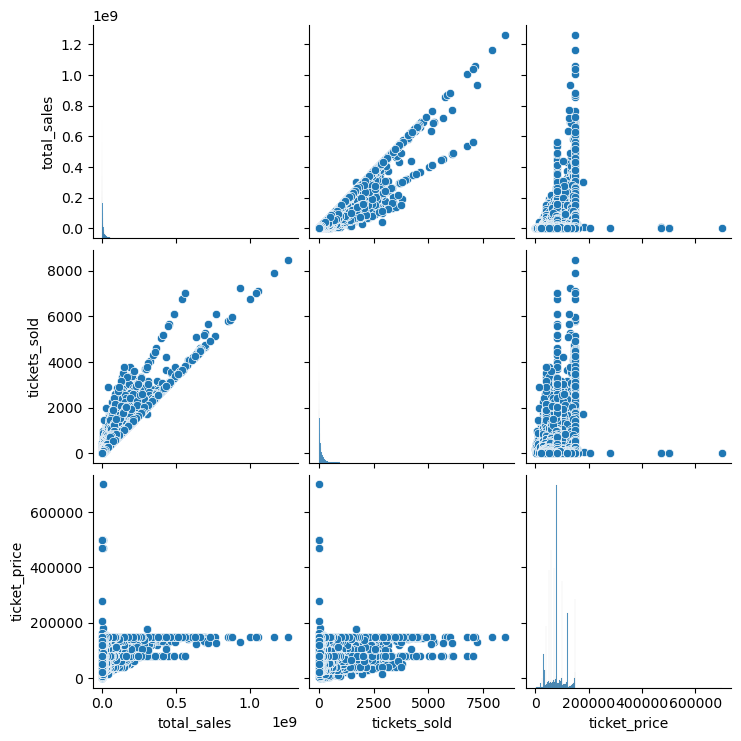

C:\Users\Lakshit Bhattacharya\AppData\Local\Temp\ipykernel_8540\1658712074.py:10: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(data.corr(), annot=True, cmap='coolwarm', fmt=".2f")


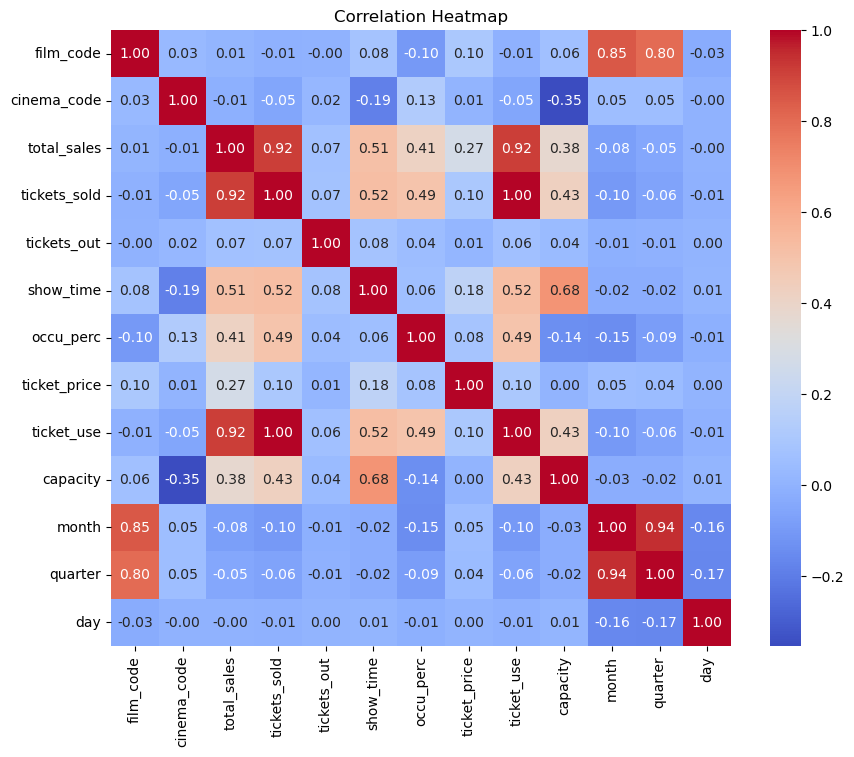

In [13]:
import matplotlib.pyplot as plt
import seaborn as sns

# pairplot to visualize relationships between numerical variables
sns.pairplot(data=data[['total_sales', 'tickets_sold', 'ticket_price']])
plt.show()

# heatmap to visualize correlations between numerical variables
plt.figure(figsize=(10, 8))
sns.heatmap(data.corr(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap')
plt.show()

In [15]:
import plotly.express as px

# Scatter plot of total_sales vs tickets_sold
fig = px.scatter(data, x='total_sales', y='tickets_sold', color='cinema_code', hover_data=['film_code'])
fig.update_layout(title='Total Sales vs Tickets Sold',
                  xaxis_title='Total Sales',
                  yaxis_title='Tickets Sold')
fig.show()

In [15]:
# Line plot of total_sales over time
fig = px.line(data, x='date', y='total_sales', title='Total Sales Over Time')
fig.update_xaxes(title='Date')
fig.update_yaxes(title='Total Sales')
fig.show()

C:\Users\Lakshit Bhattacharya\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\Lakshit Bhattacharya\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\Lakshit Bhattacharya\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\Lakshit Bhattacharya\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

C:\Users\Lakshit Bhattacharya\anaconda3\Lib\site-package

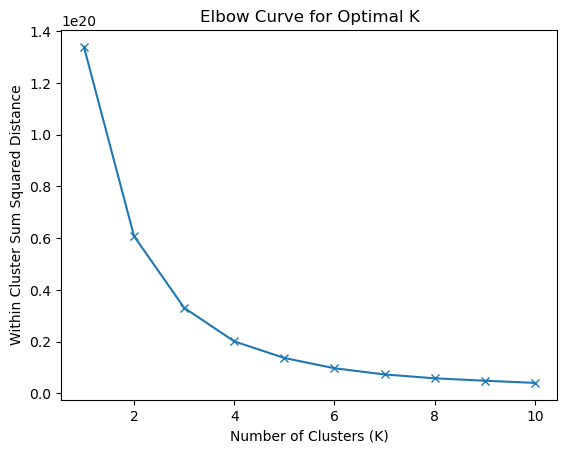

In [16]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

features = ['total_sales', 'tickets_sold', 'ticket_price']

# Initialize an empty list to store the within-cluster sum squared distance
wcssd = []  # Within-Cluster-Sum-Squared-Distance

# Define the range of clusters to try
nr_clus = range(1, 11)  # Number of Clusters

# Loop through each value of K
for k in nr_clus:
    kmeans = KMeans(n_clusters=k, init='random', random_state=111)
    kmeans.fit(data[features])  # Fit KMeans on your dataset
    wcssd.append(kmeans.inertia_)  # Append the within-cluster sum squared distance to the list

# Plot the Elbow Curve
plt.plot(nr_clus, wcssd, marker='x')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Within Cluster Sum Squared Distance')
plt.title('Elbow Curve for Optimal K')
plt.show()

In [17]:
# Initialize KMeans with the desired number of clusters
km_3cluster = KMeans(n_clusters=3, init='random', random_state=333)

# Fit KMeans and predict the cluster labels for your dataset
km_3cluster_model = km_3cluster.fit_predict(data[['total_sales', 'tickets_sold', 'ticket_price']])

# Print or use km_3cluster_model as needed
print(km_3cluster_model)

C:\Users\Lakshit Bhattacharya\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



[1 1 1 ... 1 1 1]


In [18]:
from sklearn.metrics import silhouette_score, davies_bouldin_score

# Sample a subset of your dataset (e.g., 10,000 random samples)
sampled_data = data.sample(n=10000, random_state=42)

# Use the clustering model to predict cluster labels for the sampled data
sampled_cluster_labels = km_3cluster.predict(sampled_data[['total_sales', 'tickets_sold', 'ticket_price']])

# Calculate the silhouette score for KMeans clustering with 3 clusters using the sampled data
sscore_km_3cluster = silhouette_score(sampled_data[['total_sales', 'tickets_sold', 'ticket_price']], sampled_cluster_labels)
print("Silhouette Score for KMeans with 3 clusters:", sscore_km_3cluster)

# Calculate the Davies-Bouldin score for KMeans clustering with 3 clusters using the sampled data
dbscore_km_3cluster = davies_bouldin_score(sampled_data[['total_sales', 'tickets_sold', 'ticket_price']], sampled_cluster_labels)
print("Davies-Bouldin Score for KMeans with 3 clusters:", dbscore_km_3cluster)

Silhouette Score for KMeans with 3 clusters: 0.8586550255400556
Davies-Bouldin Score for KMeans with 3 clusters: 0.4677931768057088


In [19]:
import pandas as pd

# Create a copy of your dataset
cinema_subset_kmcluster = data.copy()

# Reset the index and add a new column for cluster numbers
cinema_subset_kmcluster.reset_index(level=0, inplace=True, drop=True)
cinema_subset_kmcluster['cluster_number'] = km_3cluster_model

# Sort the DataFrame by cluster number
cinema_subset_kmcluster.sort_values('cluster_number', inplace=True)

# Display the DataFrame
print(cinema_subset_kmcluster)

        film_code  cinema_code  total_sales  tickets_sold  tickets_out  \
87777        1554          448    414555000          5189            0   
66595        1483           32    300300000          3003            0   
66594        1483          448    353460000          2365            0   
71417        1483          448    549049995          3677            0   
71418        1483          304    436350000          2933            0   
...           ...          ...          ...           ...          ...   
130102       1493          513     86760000           778            0   
130103       1493           71     81000000           547            1   
130104       1493           89     80100000           534            0   
130097       1493          304    128250000           855            0   
18185        1486          448     91429998           616            0   

        show_time  occu_perc   ticket_price  ticket_use     capacity  \
87777          31      79.60   79891.11

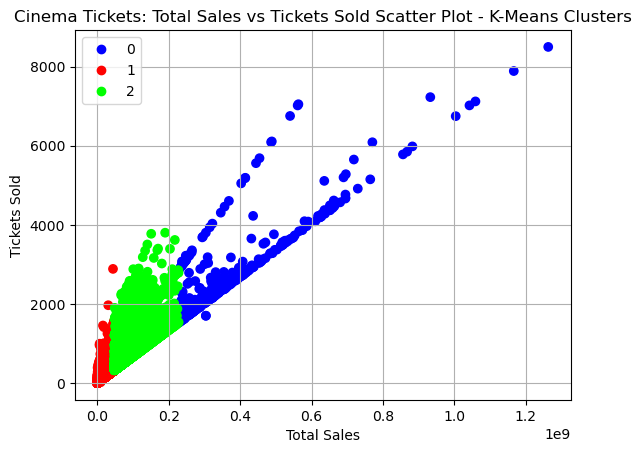

In [20]:
import matplotlib.pyplot as plt
import seaborn as sns

# Get unique cluster labels
cluster_labels = list(cinema_subset_kmcluster['cluster_number'].unique())

# Create a scatter plot
scatter_plot = plt.scatter(x='total_sales', y='tickets_sold', data=cinema_subset_kmcluster, c='cluster_number', cmap='brg')

# Add legend
plt.legend(handles=scatter_plot.legend_elements()[0], labels=cluster_labels)

# Set labels and title
plt.xlabel('Total Sales')
plt.ylabel('Tickets Sold')
plt.title('Cinema Tickets: Total Sales vs Tickets Sold Scatter Plot - K-Means Clusters')

# Show grid
plt.grid()

# Show the plot
plt.show()

In [21]:
import pandas as pd
from scipy.stats import chi2_contingency

# Assuming you have a dataframe named `cinema_subset_kmcluster` with 'cluster_number' and categorical features

# Define a list of categorical features
categorical_features = ['cinema_code', 'month', 'quarter', 'day']

# Iterate over each cluster
for cluster_label in cinema_subset_kmcluster['cluster_number'].unique():
    # Subset the dataframe for the current cluster
    cluster_data = cinema_subset_kmcluster[cinema_subset_kmcluster['cluster_number'] == cluster_label]
    
    # Initialize a dictionary to store contingency tables for each feature
    contingency_tables = {}
    
    # Create contingency tables for each categorical feature
    for feature in categorical_features:
        contingency_table = pd.crosstab(cluster_data[feature], cluster_data['cluster_number'])
        contingency_tables[feature] = contingency_table
        
    # Perform Chi-Square test of independence for each feature
    for feature, contingency_table in contingency_tables.items():
        chi2, p, dof, expected = chi2_contingency(contingency_table)
        print(f"Cluster {cluster_label}: Chi-Square test for {feature}: p-value = {p}")

Cluster 0: Chi-Square test for cinema_code: p-value = 1.0
Cluster 0: Chi-Square test for month: p-value = 1.0
Cluster 0: Chi-Square test for quarter: p-value = 1.0
Cluster 0: Chi-Square test for day: p-value = 1.0
Cluster 1: Chi-Square test for cinema_code: p-value = 1.0
Cluster 1: Chi-Square test for month: p-value = 1.0
Cluster 1: Chi-Square test for quarter: p-value = 1.0
Cluster 1: Chi-Square test for day: p-value = 1.0
Cluster 2: Chi-Square test for cinema_code: p-value = 1.0
Cluster 2: Chi-Square test for month: p-value = 1.0
Cluster 2: Chi-Square test for quarter: p-value = 1.0
Cluster 2: Chi-Square test for day: p-value = 1.0


In [22]:
from scipy.stats import f_oneway

# Assuming you have a dataframe named `cinema_subset_kmcluster` with 'cluster_number' and numerical features

# Define a list of numerical features
numerical_features = ['total_sales', 'tickets_sold', 'ticket_price']

# Initialize a dictionary to store data for each cluster
cluster_data = {}

# Iterate over each cluster
for cluster_label in cinema_subset_kmcluster['cluster_number'].unique():
    # Subset the dataframe for the current cluster
    cluster_data[cluster_label] = {}
    cluster_subset = cinema_subset_kmcluster[cinema_subset_kmcluster['cluster_number'] == cluster_label]
    
    # Store numerical data for the current cluster
    for feature in numerical_features:
        cluster_data[cluster_label][feature] = cluster_subset[feature]

# Perform ANOVA for each numerical feature
for feature in numerical_features:
    data = [cluster_data[cluster_label][feature] for cluster_label in cluster_data.keys()]
    f_statistic, p_value = f_oneway(*data)
    print(f"ANOVA for {feature}: F-statistic = {f_statistic}, p-value = {p_value}")

ANOVA for total_sales: F-statistic = 217134.65070972458, p-value = 0.0
ANOVA for tickets_sold: F-statistic = 117122.49807878712, p-value = 0.0
ANOVA for ticket_price: F-statistic = 4307.9877586263665, p-value = 0.0
